# Musical key classification
Classifying keys in a piece of music using a Hidden Markov Model trained using Spotify data.

Let's visualize the *Chroma vectors*.

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

In [3]:
df = pd.read_csv('../example/39C5FuZ8C8M0QI8CrMsPkR.txt')
df

,start,duration,confidence,pitch,chroma
0,0.00000,0.11279,0.000,1.000,"C (also B♯, D#)"
1,0.00000,0.11279,0.000,0.707,"C♯, D♭ (also B#)"
2,0.00000,0.11279,0.000,0.374,"D (also C#, E#)"
3,0.00000,0.11279,0.000,0.391,"D♯, E♭ (also F#)"
4,0.00000,0.11279,0.000,0.390,"E (also D#, F♭)"
...,...,...,...,...,...
18199,466.14078,1.49923,0.382,0.672,"G (also F#, A#)"
18200,466.14078,1.49923,0.382,0.563,"G♯, A♭"
18201,466.14078,1.49923,0.382,0.490,"A (also G#, B#)"
18202,466.14078,1.49923,0.382,0.561,"A♯, B♭ (also C#)"


In [4]:
max_pitch = df.groupby('start')['pitch'].transform(max) == df['pitch']
linedf = df[max_pitch]
linedf

,start,duration,confidence,pitch,chroma
0,0.00000,0.11279,0.000,1.0,"C (also B♯, D#)"
13,0.11279,0.22390,1.000,1.0,"C♯, D♭ (also B#)"
25,0.33669,0.13324,0.459,1.0,"C♯, D♭ (also B#)"
39,0.46993,0.20295,0.484,1.0,"D♯, E♭ (also F#)"
55,0.67288,0.24562,0.729,1.0,"G (also F#, A#)"
...,...,...,...,...,...
18154,464.90414,0.19773,0.176,1.0,"A♯, B♭ (also C#)"
18156,465.10187,0.53959,0.479,1.0,"C (also B♯, D#)"
18173,465.64145,0.23755,0.373,1.0,"F (also E♯, G#)"
18185,465.87900,0.26177,0.114,1.0,"F (also E♯, G#)"


Text(0.5, 1.0, "Chroma vectors of first 5 seconds of 'Foreplay / Long Time' track.")

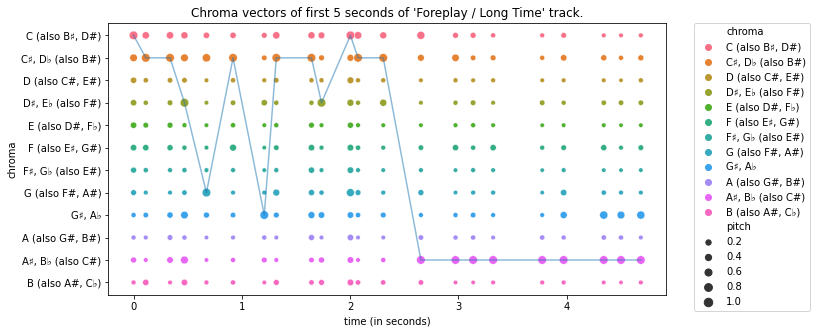

In [5]:
fig, ax = plt.subplots(figsize=(10, 5))
sns.scatterplot(x='start', y='chroma', size='pitch',
    data=df[df['start'] < 5], ax=ax, hue='chroma')
sns.lineplot(x='start', y='chroma', alpha=0.5,
    data=linedf[linedf['start'] < 5], ax=ax, sort=False)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.xlabel('time (in seconds)')
plt.title('Chroma vectors of first 5 seconds of \'Foreplay / Long Time\' track.')

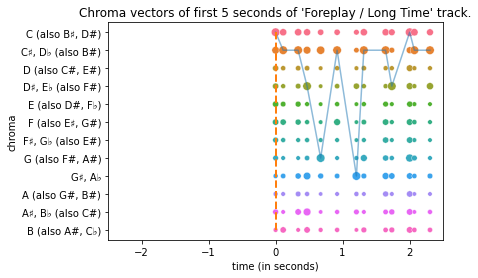

In [18]:
from matplotlib.animation import FuncAnimation
def create_frame(frame, ax): # arguments are `frame number` and `fargs`
    ax.cla()
    window = 5 # show a window of 5 seconds
    step = frame/20 # advance 0.05 seconds per frame
    x1 = -window/2 + step
    x2 = window/2 + step
    scattersamples = (df['start'] >= x1) & (df['start'] <= x2)
    sns.scatterplot(x='start', y='chroma', size='pitch',
        data=df[scattersamples], ax=ax, hue='chroma', legend=False)
    linesamples = (linedf['start'] >= x1) & (linedf['start'] <= x2)
    sns.lineplot(x='start', y='chroma', alpha=0.5,
        data=linedf[linesamples], ax=ax, sort=False, legend=False)
    ax.set_xlim(x1, x2)
    line1, = ax.plot(
            [x1+window/2, x1+window/2],
            ['C (also B♯, D#)', 'B (also A#, C♭)'],
            '--', linewidth=2, label='Dashes set retroactively')
    plt.xlabel('time (in seconds)')
    plt.title('Chroma vectors of first 5 seconds of \'Foreplay / Long Time\' track.')
fig = plt.figure()
ax = fig.gca()
create_frame(0, ax)

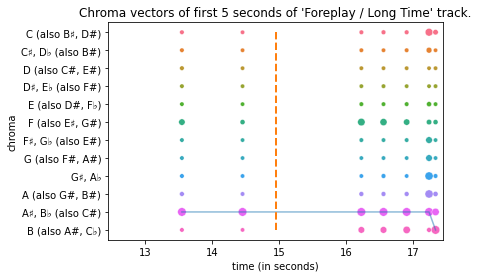

In [19]:
from IPython.display import HTML
from celluloid import Camera
fig = plt.figure()
ax = fig.gca()
animation = FuncAnimation(fig, create_frame, frames=300, fargs=(ax,),
    interval=50) # Interval at 1000/50 = 20 frames per second
HTML(animation.to_jshtml())

MovieWriter imagemagick unavailable; using Pillow instead.


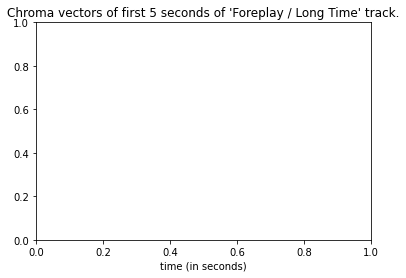

In [20]:
animation.save('../example/39C5FuZ8C8M0QI8CrMsPkR.gif', writer='imagemagick', fps=20)

In [15]:
import IPython
IPython.display.Audio("../example/39C5FuZ8C8M0QI8CrMsPkR.mp3")